In [22]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import ydata_profiling as dp
from sklearn.preprocessing import LabelEncoder
from sklearn.impute import SimpleImputer
import shap
import lightgbm as lgb
from sklearn.feature_selection import VarianceThreshold as vt
from fastapi import FastAPI
## mlflow
import mlflow
import mlflow.sklearn
mlflow.__version__
client = mlflow.tracking.MlflowClient()

In [23]:
mlflow.set_tracking_uri(uri="http://127.0.0.1:5000")


## EDA

In [24]:
%matplotlib inline
## Load the dataset
df = pd.read_csv('../data/fraud_claims.csv')
df.head()

,months_as_customer,age,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,policy_annual_premium,umbrella_limit,insured_zip,...,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_model,auto_year,fraud_reported,_c39
0,328,48,521585,2014-10-17,OH,250/500,1000,1406.91,0,466132,...,YES,71610,6510,13020,52080,Saab,92x,2004,Y,NaN
1,228,42,342868,2006-06-27,IN,250/500,2000,1197.22,5000000,468176,...,?,5070,780,780,3510,Mercedes,E400,2007,Y,NaN
2,134,29,687698,2000-09-06,OH,100/300,2000,1413.14,5000000,430632,...,NO,34650,7700,3850,23100,Dodge,RAM,2007,N,NaN
3,256,41,227811,1990-05-25,IL,250/500,2000,1415.74,6000000,608117,...,NO,63400,6340,6340,50720,Chevrolet,Tahoe,2014,Y,NaN
4,228,44,367455,2014-06-06,IL,500/1000,1000,1583.91,6000000,610706,...,NO,6500,1300,650,4550,Accura,RSX,2009,N,NaN


In [25]:
df.columns

Index(['months_as_customer', 'age', 'policy_number', 'policy_bind_date',
       'policy_state', 'policy_csl', 'policy_deductable',
       'policy_annual_premium', 'umbrella_limit', 'insured_zip', 'insured_sex',
       'insured_education_level', 'insured_occupation', 'insured_hobbies',
       'insured_relationship', 'capital-gains', 'capital-loss',
       'incident_date', 'incident_type', 'collision_type', 'incident_severity',
       'authorities_contacted', 'incident_state', 'incident_city',
       'incident_location', 'incident_hour_of_the_day',
       'number_of_vehicles_involved', 'property_damage', 'bodily_injuries',
       'witnesses', 'police_report_available', 'total_claim_amount',
       'injury_claim', 'property_claim', 'vehicle_claim', 'auto_make',
       'auto_model', 'auto_year', 'fraud_reported', '_c39'],
      dtype='object')

In [26]:
df.shape

(1000, 40)

In [27]:
## encode target variable
df['fraud_reported'] = df['fraud_reported'].map({'Y': 1, 'N': 0})


### Handle missing data

In [28]:
df.isna().sum()

months_as_customer                0
age                               0
policy_number                     0
policy_bind_date                  0
policy_state                      0
policy_csl                        0
policy_deductable                 0
policy_annual_premium             0
umbrella_limit                    0
insured_zip                       0
insured_sex                       0
insured_education_level           0
insured_occupation                0
insured_hobbies                   0
insured_relationship              0
capital-gains                     0
capital-loss                      0
incident_date                     0
incident_type                     0
collision_type                    0
incident_severity                 0
authorities_contacted            91
incident_state                    0
incident_city                     0
incident_location                 0
incident_hour_of_the_day          0
number_of_vehicles_involved       0
property_damage             

In [29]:
## check for missing values
missing_cols = df.columns[(df == '?').any()].tolist()
print("Columns with missing values:", missing_cols)



Columns with missing values: ['collision_type', 'property_damage', 'police_report_available']


In [30]:
df.replace('?', np.nan, inplace=True)
## impute missing values using mode for columns with missing values
df['collision_type'] =df['collision_type'].fillna(df['collision_type'].mode()[0])
df['property_damage'] =df['property_damage'].fillna(df['property_damage'].mode()[0])
df['police_report_available'] =df['police_report_available'].fillna(df['police_report_available'].mode()[0])

### Data Visualization

In [31]:
## profile the dataset
profile = dp.ProfileReport(df, title="YData Profiling Report", explorative=True)
## display the profile report
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 40/40 [00:00<00:00, 296417.24it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [32]:
## save the profile report
profile.to_file("../reports/data_profile.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

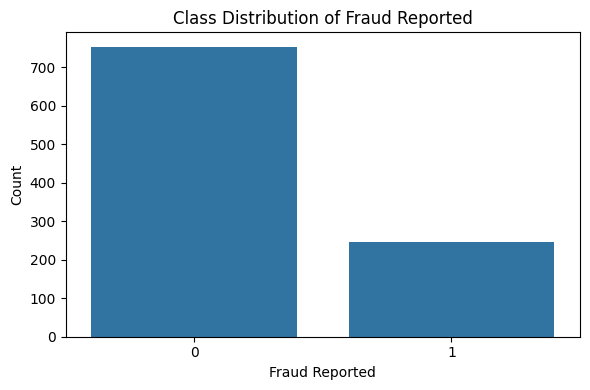

In [33]:
# Plot class distribution
fig1, ax1 = plt.subplots(figsize=(6, 4))
sns.countplot(data=df, x='fraud_reported', ax=ax1)
plt.title('Class Distribution of Fraud Reported')
plt.xlabel('Fraud Reported')
plt.ylabel('Count')
plt.tight_layout()
# plt.savefig("class_distribution.png")
# mlflow.log_figure(fig1, "class_distribution.png")
plt.show()
plt.close(fig1)

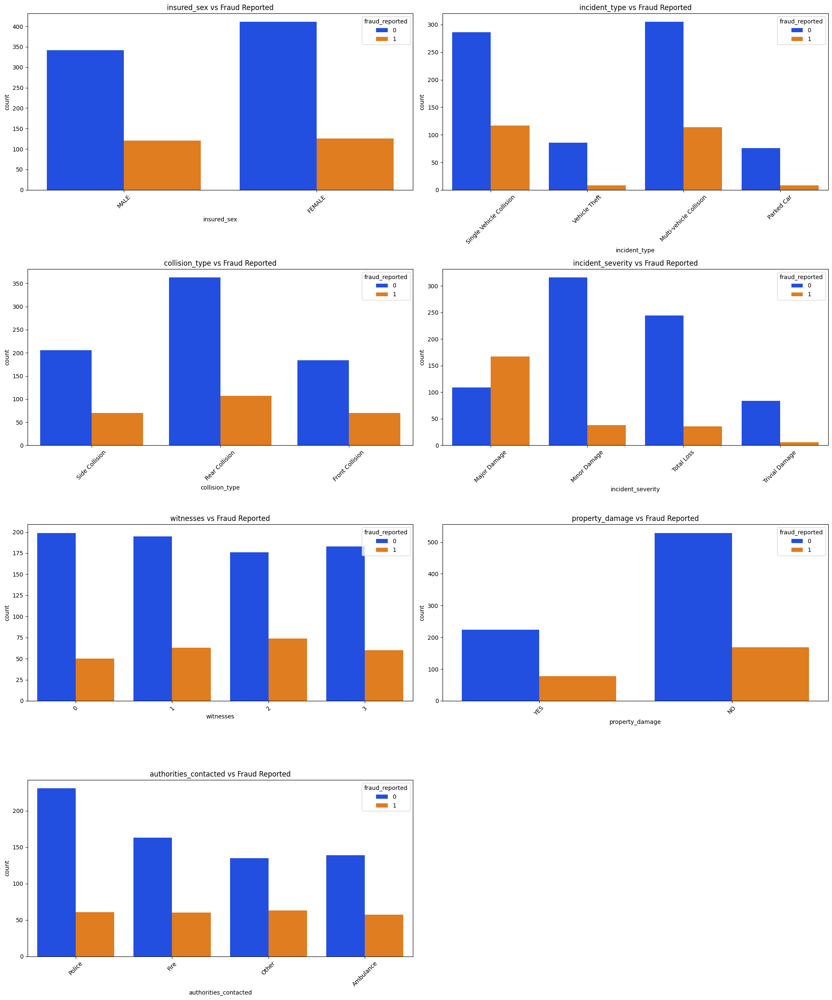

In [34]:
## count plot visaulization as it relates to target variable fraud_reported

countplot_col = [
    'insured_sex', 'incident_type', 'collision_type', 'incident_severity',
    'witnesses', 'property_damage', 'authorities_contacted'
]

fig2, axs = plt.subplots(4, 2, figsize=(20, 24))  # 7 plots => 4 rows x 2 cols is enough
axs = axs.flatten()  # Flatten to simplify indexing

for i, col in enumerate(countplot_col):
    sns.countplot(data=df, x=col, hue='fraud_reported', palette='bright', ax=axs[i])
    axs[i].set_title(f"{col} vs Fraud Reported")
    axs[i].tick_params(axis='x', rotation=45)

# Remove unused subplot (if any)
for j in range(len(countplot_col), len(axs)):
    fig2.delaxes(axs[j])

plt.tight_layout()
#plt.savefig("fraud_countplots.png")
plt.show()
# mlflow.log_figure(fig2, "fraud_countplots.png")
plt.close(fig2)

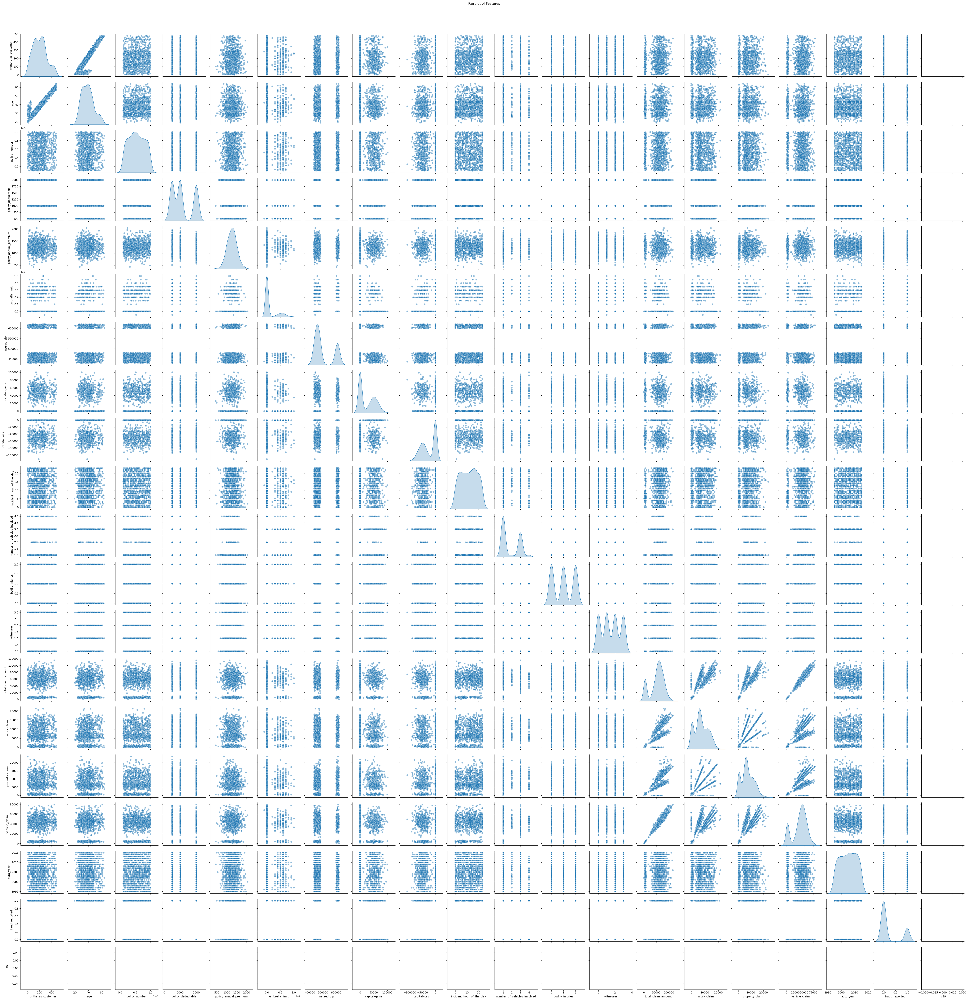

In [35]:
## pairplot of features
pairplot = sns.pairplot(df, diag_kind='kde', plot_kws={'alpha': 0.5})
fig3 = pairplot.figure 

fig3.suptitle('Pairplot of Features', y=1.02)

# Log to MLflow
# mlflow.log_figure(fig3, "pairplot.png")

# Show and close
plt.show()
plt.close(fig3)

## Feature Engineering
- Use information from data profiling to create new features that can help improve the model's performance.

In [36]:
## drop columns that have high correlation and and are not useful for prediction
drop_columns = ['policy_number', '_c39', 'policy_bind_date', 'incident_date', 
    'insured_zip', 'incident_location', 'incident_city', 'incident_state',
     'auto_model', 'policy_state','policy_csl','policy_annual_premium', 'capital-gains', 
     'capital-loss']

df.drop(columns=drop_columns, inplace=True)


In [37]:
# bin hour of the day into categories
df['incident_hour_bin'] = pd.cut(
    df['incident_hour_of_the_day'],
    bins=[0, 6, 12, 18, 24],
    labels=['Night', 'Morning', 'Afternoon', 'Evening'],
    include_lowest=True
)
df.drop(columns=['incident_hour_of_the_day'], inplace=True)
# encode incident_hour_bin
le = LabelEncoder()
df['incident_hour_bin'] = le.fit_transform(df['incident_hour_bin'])


In [38]:


# total_claim vs. sum of components to check for consistency
df['claim_ratio'] = df['total_claim_amount'] / (
    df['injury_claim'] + df['property_claim'] + df['vehicle_claim'] + 1
)

# encode categorical
cat_cols = df.select_dtypes(include='object').columns.tolist()
if 'fraud_reported' in cat_cols:
    cat_cols.remove('fraud_reported')

# encode categorical variables using label encoding  
label_encoders = {}
for col in cat_cols:
    le = LabelEncoder()
    df[col] = le.fit_transform(df[col].astype(str))
    label_encoders[col] = le

df.head()

,months_as_customer,age,policy_deductable,umbrella_limit,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,incident_type,...,police_report_available,total_claim_amount,injury_claim,property_claim,vehicle_claim,auto_make,auto_year,fraud_reported,incident_hour_bin,claim_ratio
0,328,48,1000,0,1,4,2,17,0,2,...,1,71610,6510,13020,52080,10,2004,1,3,0.999986
1,228,42,2000,5000000,1,4,6,15,2,3,...,0,5070,780,780,3510,8,2007,1,2,0.999803
2,134,29,2000,5000000,0,6,11,2,3,0,...,0,34650,7700,3850,23100,4,2007,0,2,0.999971
3,256,41,2000,6000000,0,6,1,2,4,2,...,0,63400,6340,6340,50720,3,2014,1,3,0.999984
4,228,44,1000,6000000,1,0,11,2,4,3,...,0,6500,1300,650,4550,0,2009,0,1,0.999846


In [39]:
### feature selection 

X = df.drop("fraud_reported", axis=1)
y = df["fraud_reported"]


In [40]:
print("Final features shape:", X.shape)

Final features shape: (1000, 26)


In [41]:
# save selected features and processed data
selected_features = X.columns.tolist()
print("Selected features:", selected_features)
pd.DataFrame(selected_features, columns=['features']).to_csv("../data/selected_features.csv", index=False)
X['fraud_reported'] = y
X.to_csv("../data/processed_insurance_data.csv", index=False)

Selected features: ['months_as_customer', 'age', 'policy_deductable', 'umbrella_limit', 'insured_sex', 'insured_education_level', 'insured_occupation', 'insured_hobbies', 'insured_relationship', 'incident_type', 'collision_type', 'incident_severity', 'authorities_contacted', 'number_of_vehicles_involved', 'property_damage', 'bodily_injuries', 'witnesses', 'police_report_available', 'total_claim_amount', 'injury_claim', 'property_claim', 'vehicle_claim', 'auto_make', 'auto_year', 'incident_hour_bin', 'claim_ratio']


### setup mlflow for experiment tracking

In [42]:
# === log EDA & Features to MLflow ===
# create an MLflow experiment

experiment_name = "Auto Insurance Fraud Detection"

mlflow.create_experiment(experiment_name, artifact_location="./mlartifacts")
experiment_id = mlflow.set_experiment(experiment_name)
with mlflow.start_run(run_name="EDA and Feature Engineering"):
    mlflow.log_artifact("../reports/data_profile.html")
    mlflow.log_artifact("../data/selected_features.csv")
    mlflow.log_figure(fig1, 'class_distribution.png')
    mlflow.log_figure(fig2, 'fraud_countplots.png')
    mlflow.log_figure(fig3, 'pairplot.png')
    # mlflow.end_run()

🏃 View run EDA and Feature Engineering at: http://127.0.0.1:5000/#/experiments/147046143188902615/runs/121ccc109d3a45b18a718bad125947dc
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/147046143188902615
